# Описание проекта:

Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

Для начала они просят вас — аналитика — подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
from plotly import graph_objects as go
import plotly.io as pio

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [7]:
df['name'].count()

8406

Всего дата фрейм содержит записи о 8406 точках

In [8]:
len(df['name'].unique())

5614

В дата фрейме 5614 различных заведений

## Предобработка данных

In [9]:
df.duplicated().sum()

0

In [10]:
df[['name', 'address']].duplicated().sum()

0

In [11]:
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

Дубликатов нет

Есть пропуски во мноих столбцах, но удалять такие строки будет неверным решением, они могут пригодиться в дальнейшем анализе

### Создайте столбец street с названиями улиц из столбца с адресом.

In [12]:
df.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.47886,5.0,NaN,NaN,NaN,NaN,0,NaN


In [13]:
df['street'] = df['address'].apply(lambda x: x.split(',')[1].strip())

### Создайте столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7): 
- логическое значение True — если заведение работает ежедневно и круглосуточно;
- логическое значение False — в противоположном случае.

In [14]:
df['hours'] =df['hours'].str.lower()

In [15]:
df['is_24/7'] = df['hours'].str.contains('ежедневно, круглосуточно|24/7')

## Анализ данных

### Какие категории заведений представлены в данных? Исследуйте количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Ответьте на вопрос о распределении заведений по категориям

In [16]:
df.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.47886,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False


In [17]:
df['category'].value_counts()

кафе               2378
ресторан           2043
кофейня            1413
бар,паб             765
пиццерия            633
быстрое питание     603
столовая            315
булочная            256
Name: category, dtype: int64

In [18]:
category_counts = df['category'].value_counts()

In [19]:
color_palette = sns.color_palette("pastel")

In [20]:
df.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.47886,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False


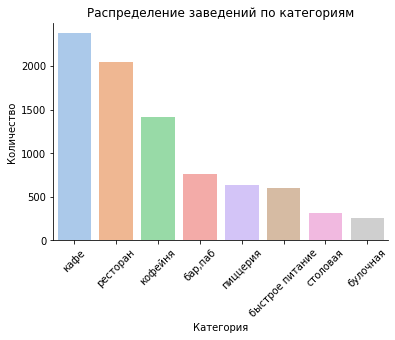

In [21]:
ax = sns.countplot(
    x=df['category'], 
    order = df['category'].value_counts().index,
    palette = color_palette
)
sns.despine()
plt.xticks(rotation=45)
ax.set_title('Распределение заведений по категориям')
ax.set_xlabel('Категория')
ax.set_ylabel('Количество');


In [22]:
category_counts

кафе               2378
ресторан           2043
кофейня            1413
бар,паб             765
пиццерия            633
быстрое питание     603
столовая            315
булочная            256
Name: category, dtype: int64

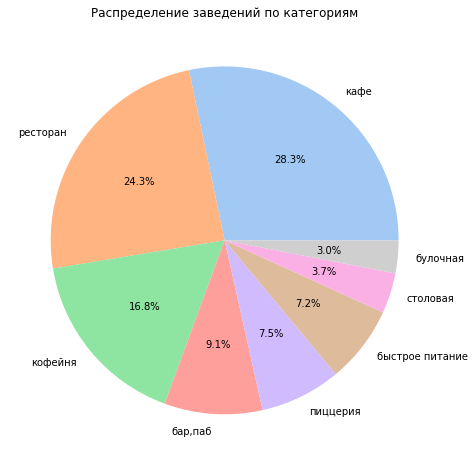

In [23]:
plt.figure(figsize=(8, 8))
plt.pie(
    category_counts,
    labels=category_counts.index,
    autopct='%1.1f%%',
    colors=color_palette
)
plt.title('Распределение заведений по категориям')
plt.show()

По графикам можно сделать следующие выводы:

Более 50% всего общепита занимают кафе (2378 точек или 28%) и рестораны (2043 точек или 24%)

Кофейни занимают почти 17% рынка, остальные категории имеют менее 10%


### Исследуйте количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Проанализируйте результаты и сделайте выводы.

In [24]:
df.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.47886,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False


In [25]:
df['seats'].describe()

count    4795.000000
mean      108.421689
std       122.833396
min         0.000000
25%        40.000000
50%        75.000000
75%       140.000000
max      1288.000000
Name: seats, dtype: float64

In [26]:
len(df[df['seats'] == 0])

136

In [27]:
round(len(df[df['seats'] == 0]) / len(df), 3) * 100

1.6

136 точек вовсе не имеют сидячих мест, что соствляет 1.6% от общего числа заведений

In [28]:
(df['seats'].quantile(0.75) - df['seats'].quantile(0.25)) * 1.5 + df['seats'].quantile(0.75)

290.0

75 квантиль + 1.5 * IQR = 290 

290 сидячих мест - это верхнаяя граница

In [29]:
len(df[df['seats'] > (df['seats'].quantile(0.75) - df['seats'].quantile(0.25)) * 1.5 + df['seats'].quantile(0.75)])

318

In [30]:
round(len(df[df['seats'] > (df['seats'].quantile(0.75) - df['seats'].quantile(0.25)) * 1.5 + df['seats'].quantile(0.75)]) / len(df) * 100, 2)

3.78

Дата фрейм содержит 318 или 3.78% заведений с аномально большим числом сидячх мест

In [31]:
df.groupby('category').agg({'seats':'median'}).sort_values(by='seats',ascending=False)

,seats
category,
ресторан,86.0
"бар,паб",82.5
кофейня,80.0
столовая,75.5
быстрое питание,65.0
кафе,60.0
пиццерия,55.0
булочная,50.0


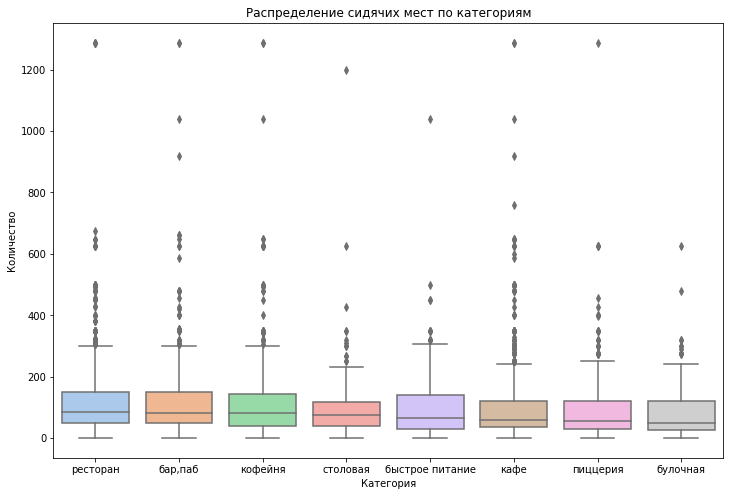

In [32]:
plt.figure(figsize=(12, 8))
sns.boxplot(
    data=df,
    x='category',
    y='seats',
    order=df.groupby('category')['seats'].median().sort_values(ascending=False).index,
    palette = color_palette
)
plt.title('Распределение сидячих мест по категориям')
plt.xlabel('Категория')
plt.ylabel('Количество');

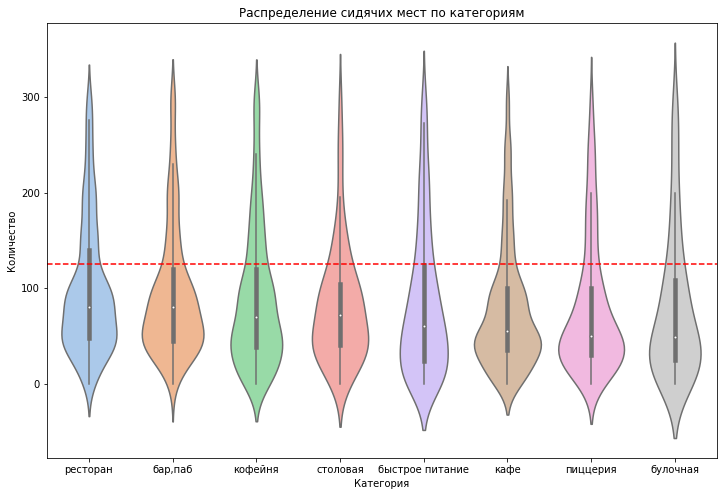

In [33]:
plt.figure(figsize=(12, 8))
sns.violinplot(
    data=df[df['seats'] <= 300],
    x='category',
    y='seats',
    order=df.groupby('category')['seats'].median().sort_values(ascending=False).index,
    palette = color_palette
)
plt.title('Распределение сидячих мест по категориям')
plt.xlabel('Категория')
plt.ylabel('Количество');

plt.axhline(y=125, linestyle='dashed', color='red');

Выводы:
- Средее значение посадочных мест у всех заведений равно 108
- Максимальное значение мест 1288
- В дата фрейме 136 точек вовсе не имеют сидячих мест, что соствляет 1.6% от общего числа заведений
- Дата фрейм содержит 318 или 3.78% заведений с аномально большим числом сидячх мест
- Медианное значение сидячих мест больше всего у категорий:
    - Ресторан 86
    - Бар, паб 82.5
    - Кофейня 80
- Меньше всего:
    - Кафе 60
    - Пиццрия 55
    - Булочная 50
 

### Рассмотрите и изобразите соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?


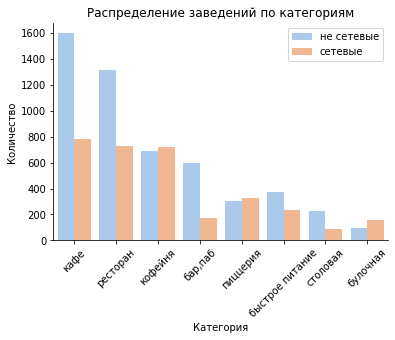

In [34]:
ax = sns.countplot(
    x=df['category'], 
    order = df['category'].value_counts().index,
    palette = color_palette,
    hue=df['chain']
)
sns.despine()
plt.xticks(rotation=45)
plt.legend(labels=['не сетевые', 'сетевые']) 
ax.set_title('Распределение заведений по категориям')
ax.set_xlabel('Категория')
ax.set_ylabel('Количество');

In [35]:
piv1 = df.pivot_table(index='category', columns='chain', values='name', aggfunc='count')

In [36]:
piv1.loc['total'] = piv1.sum()

In [37]:
piv1['total'] = piv1[0] + piv1[1]

In [38]:
piv1

chain,0,1,total
category,,,
"бар,паб",596,169,765
булочная,99,157,256
быстрое питание,371,232,603
кафе,1599,779,2378
кофейня,693,720,1413
пиццерия,303,330,633
ресторан,1313,730,2043
столовая,227,88,315
total,5201,3205,8406


In [39]:
piv1[0] = piv1[0] / piv1['total']
piv1[1] = piv1[1] / piv1['total']

In [40]:
piv1

chain,0,1,total
category,,,
"бар,паб",0.779085,0.220915,765
булочная,0.386719,0.613281,256
быстрое питание,0.615257,0.384743,603
кафе,0.672414,0.327586,2378
кофейня,0.490446,0.509554,1413
пиццерия,0.478673,0.521327,633
ресторан,0.642682,0.357318,2043
столовая,0.720635,0.279365,315
total,0.618725,0.381275,8406


In [41]:
piv1.drop('total', axis=1, inplace=True)

In [42]:
piv1[0] = piv1[0] * 100
piv1[1] = piv1[1] * 100

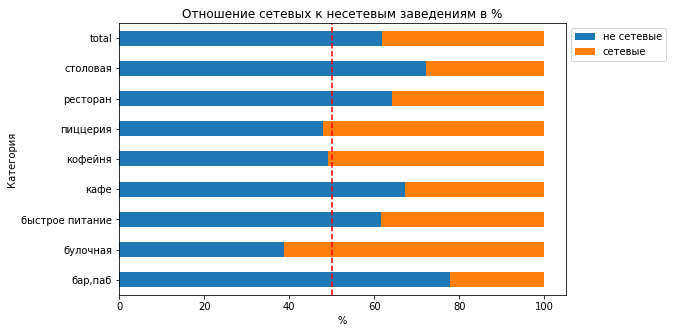

In [43]:
piv1.plot(kind='barh', stacked=True, figsize=(8, 5))
plt.legend(labels=['не сетевые', 'сетевые'] ,bbox_to_anchor=(1,1), loc='upper left')
plt.title('Отношение сетевых к несетевым заведениям в %')
plt.xlabel('%')
plt.ylabel('Категория')
plt.axvline(x=50, color='red', linestyle='--', label='60%');

Выводы:

Всего 5201 **не сетевых** и 3205 **сетевых** заведений, то есть около 62% не сетевых и 38% сетевых

### Какие категории заведений чаще являются сетевыми? Исследуйте данные и ответьте на вопрос графиком.

Выводы:
- не сетевыми в чаще являются:
    - столовая
    - ресторан
    - кафе
    - быстрое питание
    - бар, паб
- примерно в равном соотношении:
    - пиццерия
    - кофейня
- сетевыми чаще являются:
    - болочная

### Сгруппируйте данные по названиям заведений и найдите топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Постройте подходящую для такой информации визуализацию. Знакомы ли вам эти сети? Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?

In [44]:
top_names = df[df['chain'] == 1].groupby('name').agg(
    count=('rating', 'count'),
    category=('category', 'first'),
    unique_categories=('category', 'nunique')
).sort_values(by='count', ascending=False).reset_index().head(15)


In [45]:
top_names

,name,count,category,unique_categories
0,Шоколадница,120,кофейня,2
1,Домино'с Пицца,76,пиццерия,1
2,Додо Пицца,74,пиццерия,1
3,One Price Coffee,71,кофейня,1
4,Яндекс Лавка,69,ресторан,1
5,Cofix,65,кофейня,1
6,Prime,50,ресторан,2
7,Хинкальная,44,быстрое питание,5
8,КОФЕПОРТ,42,кофейня,1
9,Кулинарная лавка братьев Караваевых,39,кафе,1


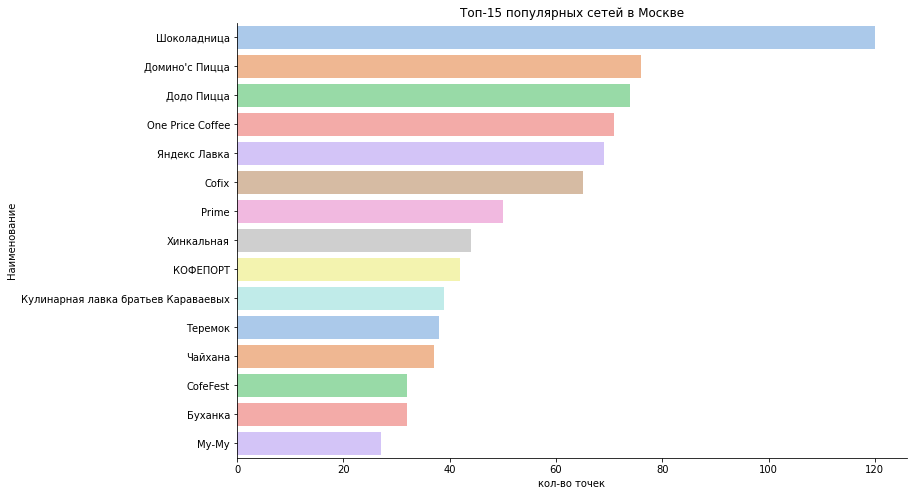

In [46]:
plt.figure(figsize=(12, 8))
ax = sns.barplot(
    data=top_names,
    y='name', 
    x='count',
    palette = color_palette
)
sns.despine()
ax.set_title('Топ-15 популярных сетей в Москве')
ax.set_xlabel('кол-во точек')
ax.set_ylabel('Наименование');

Шоколадница имеет гораздо больше точек, чем у других сетей

In [47]:
df[df['name'] == 'Му-Му']['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'быстрое питание', 'пиццерия',
       'столовая', 'бар,паб'], dtype=object)

In [48]:
df['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

Можно заметить, что в рамках одной сети заведения имеют различные категорииб, например, Му-Му включает в себя заведения 7 категори из 8 присутствующих в дата-сете

Топ 15 заведений содержит все 8 имеющихся категорий

Некоторые из представленных в топе заведений распространены и в других городах РФ

In [49]:
top_names['name'].values

array(['Шоколадница', "Домино'с Пицца", 'Додо Пицца', 'One Price Coffee',
       'Яндекс Лавка', 'Cofix', 'Prime', 'Хинкальная', 'КОФЕПОРТ',
       'Кулинарная лавка братьев Караваевых', 'Теремок', 'Чайхана',
       'CofeFest', 'Буханка', 'Му-Му'], dtype=object)

In [50]:
df_top = df[df['name'].isin(top_names['name'].values)]

In [51]:
len(df_top)

816

Всего в топ 15 сетей входят 816 точек

In [52]:
price_top_15 = df_top.groupby('price')['name'].count().sort_values(ascending=False)

In [53]:
from plotly import graph_objects as go

In [54]:
df_price = df.groupby('price')['name'].count().sort_values(ascending=False)

In [55]:
fig = go.Figure(data=[go.Pie(labels=df_price.index, values=df_price.values)])
fig.update_layout(title='Распределение всех заведений по ценовой категории')
fig.show() 

In [56]:
fig = go.Figure(data=[go.Pie(labels=price_top_15.index, values=price_top_15.values)])
fig.update_layout(title='Распределение заведений из топ 15 по ценовой категории')
fig.show() 

По графику можно сказать, что подавляющее большинство заведений (87%) из топ 15 находятся в средней ценовой катеории

Хотя лишь 63% из полного дата сета имеют седнюю ценовую категорию


поэтому именно этот признак и объединяет сети из топ 15

In [57]:
df_district = df.groupby('district')['name'].count().sort_values(ascending=False)

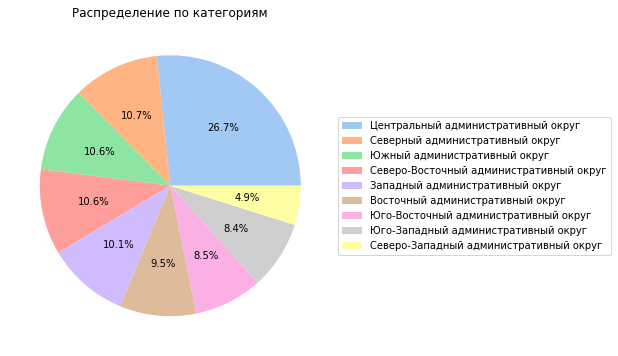

In [58]:
plt.figure(figsize=(6, 6))
plt.pie(
    df_district,
    autopct='%1.1f%%',
    colors=color_palette,
        #pctdistance=1.1
)
plt.legend(labels=df_district.index, loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.title('Распределение по категориям')
plt.show()

In [59]:
district_top_15 = df_top.groupby('district')['name'].count().sort_values(ascending=False)

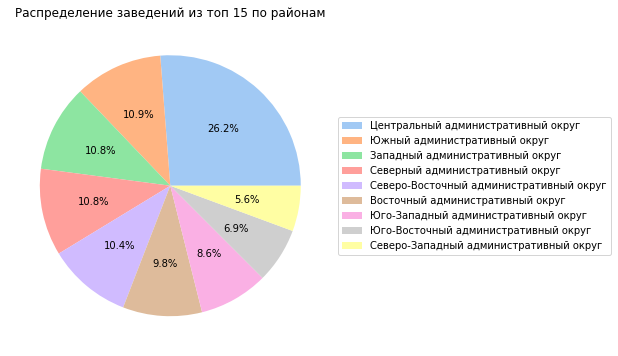

In [60]:
plt.figure(figsize=(6, 6))
plt.pie(
    district_top_15,
    autopct='%1.1f%%',
    colors=color_palette,
        #pctdistance=1.1
)
plt.legend(labels=district_top_15.index, loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.title('Распределение заведений из топ 15 по районам')
plt.show()

Нельзя с уверенностью сказать, что признак расположения является объединяющим для заведений из топ 15, так как почти такой же процент заведений взятых из основного датафрейма располагается в центральном районе

In [61]:
df_category = df.groupby('category')['name'].count().sort_values(ascending=False)

In [62]:
fig = go.Figure(data=[go.Pie(labels=df_category.index, values=df_category.values)])
fig.update_layout(title='Распределение категорий из топ 15 по ценовой категории')
fig.show()

In [63]:
category_top_15 = df_top.groupby('category')['name'].count().sort_values(ascending=False)

In [64]:
fig = go.Figure(data=[go.Pie(labels=category_top_15.index, values=category_top_15.values)])
fig.update_layout(title='Распределение категорий из топ 15 по ценовой категории')
fig.show() 

Можно отметить, что 41.2% заведений из топ 15 являются кофенями, а из всего дата-сета 28% заведений являются кофейнями, поэтому можно сделать вывод, что и категория "Кофейня" также является отличительной чертой заведейний из топ 15

Выводы:
- Самыми популярными сетями в Мск являются:
    - Шоколадница
    - Домино'с Пицца	
    - Додо Пицца
- Всего 816 заведений по Мск, входящих в топ 15
- Факторы, объединяющие заведения из топ 15:
    - заведения в боьшинстве своем (87%) имеют среднюю ценовую категорию
    - большая часть завеений (41%) из топ 15  являются кофейнями

### Какие административные районы Москвы присутствуют в датасете? Отобразите общее количество заведений и количество заведений каждой категории по районам. Попробуйте проиллюстрировать эту информацию одним графиком.

In [65]:
df_district.loc['total'] = df_district.sum()

In [66]:
df_district = df_district.reset_index().rename(columns={'name':'count'})

In [67]:
df_district

,district,count
0,Центральный административный округ,2242
1,Северный административный округ,900
2,Южный административный округ,892
3,Северо-Восточный административный округ,891
4,Западный административный округ,851
5,Восточный административный округ,798
6,Юго-Восточный административный округ,714
7,Юго-Западный административный округ,709
8,Северо-Западный административный округ,409
9,total,8406


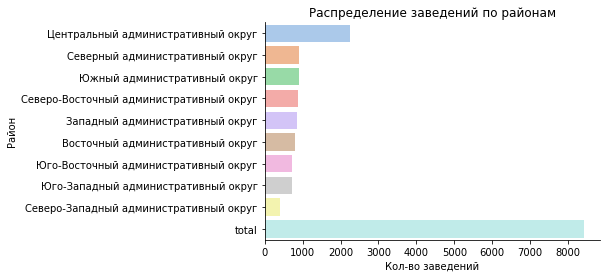

In [68]:
ax = sns.barplot(
    data = df_district,
    y='district',
    x='count',
    palette = color_palette
)
sns.despine()
ax.set_title('Распределение заведений по районам')
ax.set_xlabel('Кол-во заведений')
ax.set_ylabel('Район');


In [69]:
df2 = df.pivot_table(index='district', columns='category', values='name', aggfunc='count')
df2

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
district,,,,,,,,
Восточный административный округ,53,25,71,272,105,72,160,40
Западный административный округ,50,37,62,239,150,71,218,24
Северный административный округ,68,39,58,235,193,77,189,41
Северо-Восточный административный округ,63,28,82,269,159,68,182,40
Северо-Западный административный округ,23,12,30,115,62,40,109,18
Центральный административный округ,364,50,87,464,428,113,670,66
Юго-Восточный административный округ,38,13,67,282,89,55,145,25
Юго-Западный административный округ,38,27,61,238,96,64,168,17
Южный административный округ,68,25,85,264,131,73,202,44


Text(0, 0.5, 'Категория')

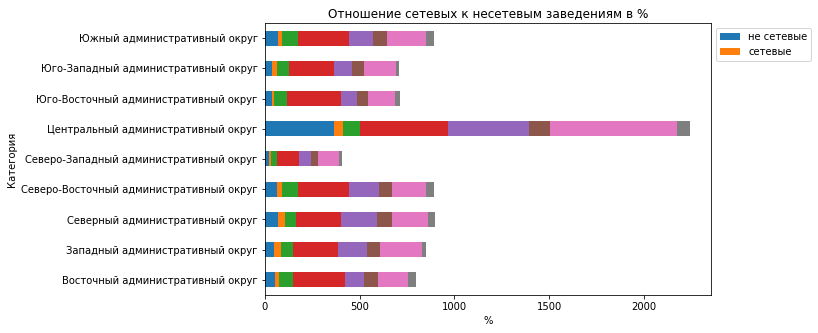

In [70]:
df2.plot(kind='barh', stacked=True, figsize=(8, 5))
plt.legend(labels=['не сетевые', 'сетевые'] ,bbox_to_anchor=(1,1), loc='upper left')
plt.title('Отношение сетевых к несетевым заведениям в %')
plt.xlabel('%')
plt.ylabel('Категория')
# plt.axvline(x=50, color='red', linestyle='--', label='60%');

In [71]:
dff2 = df.groupby(['district','category']).agg({'name':'count'}).sort_values(by='name').reset_index()

In [72]:
dff2 = dff2.rename(columns={'name':'count'})

In [73]:
r1 = df_district[df['district'] !='total']

/tmp/ipykernel_141/1810179740.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



In [74]:
r1

,district,count
0,Центральный административный округ,2242
1,Северный административный округ,900
2,Южный административный округ,892
3,Северо-Восточный административный округ,891
4,Западный административный округ,851
5,Восточный административный округ,798
6,Юго-Восточный административный округ,714
7,Юго-Западный административный округ,709
8,Северо-Западный административный округ,409
9,total,8406


In [75]:
fig = px.bar(
    data_frame=dff2,
    x='count',
    y='district',
    color='category'
)

fig.update_layout(
   # xaxis_tickangle=-45,
  #  yaxis=dict(range=[3, max(df1['street'])]),
    title='Топ 15 улиц по количеству заведений',
    xaxis_title='Количество',
    yaxis_title='Улица',
    legend=dict(x=1, y=1, title='Категория', traceorder='normal')
)

fig.show()

Всего в дата фрейме 8406 заведений, из которых 2242 располагаются в центральном округе, остальные точки распределены примерно одинаково в остальных районах, кроме Северо-западного округа. В нем наблюдается наибольший спад 

### Визуализируйте распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [76]:
mean_rating_by_category = (
    df.groupby('category') 
    .agg({'rating':'mean'})  
    .sort_values(by='rating', ascending=False) 
    .reset_index()
)

In [77]:
mean_rating_by_category

,category,rating
0,"бар,паб",4.387712
1,пиццерия,4.301264
2,ресторан,4.290357
3,кофейня,4.277282
4,булочная,4.268359
5,столовая,4.211429
6,кафе,4.123886
7,быстрое питание,4.050249


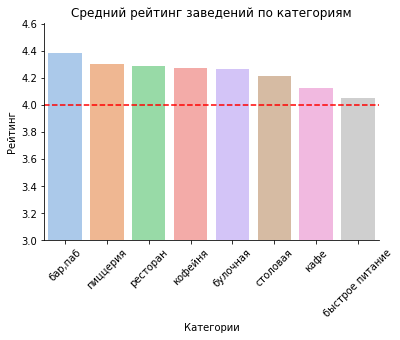

In [78]:
ax = sns.barplot(
    data = mean_rating_by_category,
    y='rating',
    x='category',
    palette = color_palette
)
sns.despine()
plt.xticks(rotation=45)
ax.set_ylim(bottom=3)
ax.axhline(y=4, color='red', linestyle='--')
ax.set_title('Средний рейтинг заведений по категориям')
ax.set_xlabel('Категории')
ax.set_ylabel('Рейтинг');

Каждая из категорий иммеет средний рейтинг не ниже 4 баллов

Также можно сказат, что категория бар,паб имеет самый высокий рейтинг, а категории кафе и быстрое питание - самый низкий

### Постройте фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson (скачать файл для локальной работы).

In [79]:
df.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.47886,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False


In [80]:
mean_rating_by_district = (
    df.groupby('district') 
    .agg({'rating':'mean'})  
    .sort_values(by='rating', ascending=False) 
    .reset_index()
)

In [81]:
mean_rating_by_district

,district,rating
0,Центральный административный округ,4.377520
1,Северный административный округ,4.239778
2,Северо-Западный административный округ,4.208802
3,Южный административный округ,4.184417
4,Западный административный округ,4.181551
5,Восточный административный округ,4.174185
6,Юго-Западный административный округ,4.172920
7,Северо-Восточный административный округ,4.148260
8,Юго-Восточный административный округ,4.101120


In [82]:
import json
with open('/datasets/admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)

In [83]:
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = '/datasets/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=mean_rating_by_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

Можно сказать, что центральный район имеет самый большой средний рейтинг

### тобразите все заведения датасета на карте с помощью кластеров средствами библиотеки folium.

In [84]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

m

### Найдите топ-15 улиц по количеству заведений. Постройте график распределения количества заведений и их категорий по этим улицам. Попробуйте проиллюстрировать эту информацию одним графиком.

In [85]:
df.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.47886,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False


In [86]:
count_by_street = (
    df.groupby('street') 
    .agg({
        'name':'count'
    })  
    .sort_values(by='name', ascending=False)
    .reset_index()
)

In [87]:
count_by_street.head(15)

,street,name
0,проспект Мира,184
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


In [88]:
count_by_street['street'].head(15).values

array(['проспект Мира', 'Профсоюзная улица', 'проспект Вернадского',
       'Ленинский проспект', 'Ленинградский проспект',
       'Дмитровское шоссе', 'Каширское шоссе', 'Варшавское шоссе',
       'Ленинградское шоссе', 'МКАД', 'Люблинская улица',
       'улица Вавилова', 'Кутузовский проспект', 'улица Миклухо-Маклая',
       'Пятницкая улица'], dtype=object)

In [89]:
df1 = (
    df[df['street'].isin(count_by_street['street'].head(15))].groupby(['street', 'category'])
    .agg({'name':'count'})
    .sort_values(by=['street'], ascending=False)
    .reset_index()
)

In [90]:

fig = px.bar(
    data_frame=df1,
    x='name',
    y='street',
    color='category',
 #   color_discrete_sequence=color_palette,
    category_orders={'street': count_by_street['street'].head(15).values
                    },
)

fig.update_layout(
    xaxis_tickangle=-45,
    yaxis=dict(range=[3, max(df1['street'])]),
    title='Топ 15 улиц по количеству заведений',
    xaxis_title='Количество',
    yaxis_title='Улица',
    legend=dict(x=1, y=1, title='Категория', traceorder='normal')
)

fig.show()


Проспект мира имеет больше всего заведений (184). 53 из них - кафе

Также больше 100 заведений имеет профсоюзная улица; проспкт Вернандского; Ленинский проспет

### Найдите улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?

In [91]:
count_by_street[count_by_street['name']==1]['street']

990              улица Фотиевой
991               улица Фадеева
992      улица Кирпичные Выемки
993                 сад Эрмитаж
994          улица Ивана Франко
                 ...           
1443      Павелецкая набережная
1444    Панкратьевский переулок
1445            Парусный проезд
1446         Певческий переулок
1447                        № 7
Name: street, Length: 458, dtype: object

In [92]:
street_has1 = df[df['street'].isin(count_by_street[count_by_street['name']==1]['street'])]

In [93]:
street_has1['rating'].mean()

4.236681222707423

средний рейтинг этих заведений равен 4.2

In [94]:
street_has1.groupby('price').agg({'name':'count'}).sort_values(by='name', ascending=False)

,name
price,
средние,120
выше среднего,29
высокие,22
низкие,11


In [95]:
street_has1.groupby('category').agg({'name':'count'}).sort_values(by='name', ascending=False)

,name
category,
кафе,160
ресторан,93
кофейня,84
"бар,паб",39
столовая,36
быстрое питание,23
пиццерия,15
булочная,8


In [96]:
street_has1.groupby('district').agg({'name':'count'}).sort_values(by='name', ascending=False)

,name
district,
Центральный административный округ,145
Северо-Восточный административный округ,55
Восточный административный округ,52
Северный административный округ,52
Южный административный округ,43
Юго-Восточный административный округ,39
Западный административный округ,35
Северо-Западный административный округ,19
Юго-Западный административный округ,18


Всего таких заведений 458

120 из них имеют среднюю ценовую категорию

145 располагаются в центральном округе

160 являются кафе

### Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитайте медиану этого столбца для каждого района. Используйте это значение в качестве ценового индикатора района. Постройте фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализируйте цены в центральном административном округе и других. Как удалённость от центра влияет на цены в заведениях?

In [97]:
df.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.47886,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False


In [98]:
median_bill_by_district = df.groupby('district').agg({'middle_avg_bill':'median'}).reset_index().sort_values(by='middle_avg_bill', ascending=False)

In [99]:
median_bill_by_district

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [100]:
Choropleth(
    geo_data=state_geo,
    data=median_bill_by_district,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек заведений по районам',
).add_to(m)

#
m

Медианный чек в западном и центральном районах равен 1000

По удалении от центра медианный чек снижается на 25% - 50%



### Соберите наблюдения по вопросам выше в один общий вывод.

Вывод:
- Более 50% всего общепита занимают кафе (2378 точек или 28%) и рестораны (2043 точек или 24%)
- Кофейни занимают почти 17% рынка, остальные категории имеют менее 10%
- Средее значение посадочных мест у всех заведений равно 108
    - у кофеен медианно езначение посадочных мест равно 80
- Всего 5201 **не сетевых** и 3205 **сетевых** заведений, то есть около 62% не сетевых и 38% сетевых
    - у кофеен этот показатель около 50%
- из топ 15 заведений (по открытым точкам) - 40% ялвяются кофенями 
- Всего в дата фрейме 8406 заведений, из которых 2242 располагаются в центральном округе, остальные точки распределены примерно одинаково в остальных районах, кроме Северо-западного округа. В нем наблюдается наибольший спад
- Бары и пабы имеют самый высокий средний рейтинг
- центральный район имеет самый большой средний рейтинг
- Проспект мира имеет больше всего заведений (184). 53 из них - кафе. Также больше 100 заведений имеет профсоюзная улица; проспкт Вернандского; Ленинский проспет
- Медианный чек в западном и центральном районах равен 1000. По удалении от центра медианный чек снижается на 25% - 50%

## Детализируем исследование: открытие кофейни

### Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?

In [101]:
cof = df[df['category'] == 'кофейня']

In [102]:
len(cof)

1413

In [103]:
df.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.47886,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False


In [104]:
cof_by_district = cof.groupby('district').agg({'name':'count'}).reset_index().sort_values(by='name', ascending=False)

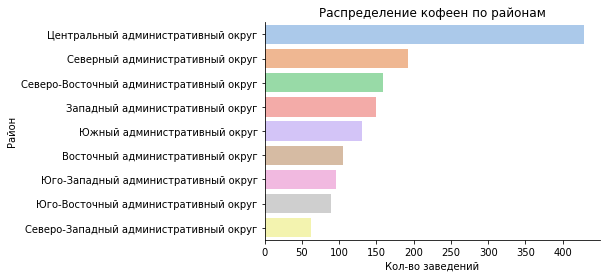

In [105]:
ax = sns.barplot(
    data = cof_by_district,
    y='district',
    x='name',
    palette = color_palette
)
sns.despine()
ax.set_title('Распределение кофеен по районам')
ax.set_xlabel('Кол-во заведений')
ax.set_ylabel('Район');

Более 400 кофеен располагается в центральном округе

In [106]:
m1 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster1 = MarkerCluster().add_to(m1)
def create_clusters1(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster1)

# применяем функцию create_clusters() к каждой строке датафрейма
cof.apply(create_clusters1, axis=1)

Choropleth(
    geo_data=state_geo,
    fill_color='YlGn',
    fill_opacity=0.1
).add_to(m1)

m1

### Есть ли круглосуточные кофейни?

In [107]:
cof_24 = cof[cof['is_24/7'] == True]

In [108]:
len(cof_24)

59

In [109]:
len(cof_24) / len(cof) * 100

4.175513092710545

Круглосуточных кофеен 59 (4.17%)

In [110]:
cof_24.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
200,Wild Bean,кофейня,"Москва, Дмитровское шоссе, 107Е",Северный административный округ,"ежедневно, круглосуточно",55.878477,37.543426,3.5,NaN,NaN,NaN,NaN,1,20.0,Дмитровское шоссе,True


In [111]:
    cof_24_by_dis = cof_24.groupby(['district']).agg({'name':'count'}).sort_values(by='name', ascending=False).reset_index()

In [112]:
cof_24_by_dis

,district,name
0,Центральный административный округ,26
1,Западный административный округ,9
2,Юго-Западный административный округ,7
3,Восточный административный округ,5
4,Северный административный округ,5
5,Северо-Восточный административный округ,3
6,Северо-Западный административный округ,2
7,Юго-Восточный административный округ,1
8,Южный административный округ,1


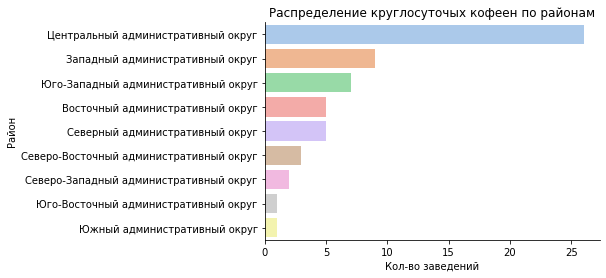

In [113]:
ax = sns.barplot(
    data = cof_24_by_dis,
    y='district',
    x='name',
    palette = color_palette
)
sns.despine()
ax.set_title('Распределение круглосуточых кофеен по районам')
ax.set_xlabel('Кол-во заведений')
ax.set_ylabel('Район');

26 круглосуточных кофеен располагаются в центральном районе, также около 10 в Западном и Юго-Западном округах

In [114]:
cof_24.groupby(['name']).agg({'district':'count'}).sort_values(by='district', ascending=False)

,district
name,
Шоколадница,17
Кофемания,8
Wild Bean Cafe,6
Wild Bean,5
Кофе Хауз,3
You&coffee,2
Cofix,2
Кофе с собой,2
Столица,1


In [115]:
len(cof_24[cof_24['chain'] == 1])

50

большинство таких кофеен - сетевые

### Какие у кофеен рейтинги? Как они распределяются по районам?

In [116]:
cof.groupby(['district']).agg({'rating':'median'}).sort_values(by='rating', ascending=False)

,rating
district,
Восточный административный округ,4.3
Северный административный округ,4.3
Северо-Восточный административный округ,4.3
Северо-Западный административный округ,4.3
Центральный административный округ,4.3
Юго-Восточный административный округ,4.3
Юго-Западный административный округ,4.3
Южный административный округ,4.3
Западный административный округ,4.2


Рейтинги распределены равномерно, лишь западный округ имеет медианный рейтинг кофеен чуть ниже остальных округов

### На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

In [117]:
cof.head(1)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.48886,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False


In [118]:
cof_cup_by_dis = (cof
    .groupby('district')
    .agg({'middle_coffee_cup':'median'})
    .reset_index()
    .sort_values(by='middle_coffee_cup', ascending=False)
)

In [119]:
cof_cup_by_dis

,district,middle_coffee_cup
7,Юго-Западный административный округ,198.0
5,Центральный административный округ,190.0
1,Западный административный округ,189.0
4,Северо-Западный административный округ,165.0
3,Северо-Восточный административный округ,162.5
2,Северный административный округ,159.0
8,Южный административный округ,150.0
6,Юго-Восточный административный округ,147.5
0,Восточный административный округ,135.0


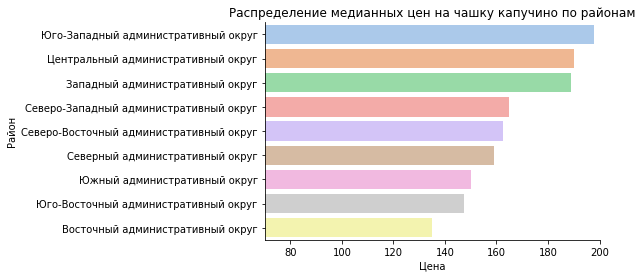

In [120]:
ax = sns.barplot(
    data = cof_cup_by_dis,
    y='district',
    x='middle_coffee_cup',
    palette = color_palette
)
sns.despine()
ax.set_xlim(70, 200)
ax.set_title('Распределение медианных цен на чашку капучино по районам')
ax.set_xlabel('Цена')
ax.set_ylabel('Район');

In [121]:
cof_price = cof.groupby('price')['name'].count().sort_values(ascending=False)

In [122]:
fig = go.Figure(data=[go.Pie(labels=cof_price.index, values=cof_price.values)])
fig.update_layout(title='Распределение кофеен по ценовой категории')
fig.show() 

In [123]:
cof_price_SE = cof[cof['district'] == 'Юго-Западный административный округ'].groupby('price')['name'].count().sort_values(ascending=False)

In [124]:
fig = go.Figure(data=[go.Pie(labels=cof_price_SE.index, values=cof_price_SE.values)])
fig.update_layout(title='Распределение кофеен по ценовой категории в Юго-Западном округе')
fig.show() 

Необходимо ориентироваться на район, где будет открыта кофейня. Например в центральном и западных округах необходимо будет поднять цену выше 150р за чашку. Скорее всего, такой разброс цен связан с более высокой арендной платой в этих районах

Рекомендации:
- Можно рекомендовать следующие районы:
    - граница восточного и юго-восточного округов (кузьминки, жулебино, выхино). Здесь наблюдается очень низкая концентрация кофеен. Но стоить заметить, что в данных районах самая низкая медианная стоимость чаши кофе, что может отпугнуть от заведния с слишком высокими ценам для этого района. 
    - центральный и приграничные зоны с западным районами. Такое расположение привлечет туристический поток. 
- Достаточно интересным форматом может стать круглосуточная работа заведения в летние преиоды. Но такой формат не подойдет для кофени, удаленной на большое расстояние от центра города
        
    

Ссылка на презентацию

https://disk.yandex.ru/i/fv7QwHhht4C15g